In [1]:
import numpy as np
import math
import matplotlib.pyplot as plt
from numba import njit
from scipy import optimize
from scipy import interpolate
from mpl_toolkits import mplot3d

In [2]:
beta = 0.9    # discount factor
nk = 30     # capital grid points
delta = 0    # depreciation rate
ns = 10   # grid points for the shock

eps = 0.01    # convergence criterion
max_iter = 200    # maximum number of iterations

# Utility mode
# 0: log utility
# 1: u(c) = - c ** (-4)
utility_mode = 0

# Interpolation mode:
# 0: Linear
# 1: Polynomial of deg 5
# 2: Cubic splines
interpolation_mode = 0

In [3]:
def utility(c, utility_mode):
    if utility_mode == 0:
        u = math.log(c)
    else:
        u = -c ** (-4)

    return u


def uprime(c, utility_mode):
    if utility_mode == 0:
        up = 1 / c
    else:
        up = (-4) * c ** (-3)
    return up

In [4]:
def euler(kprime, k, kgrid, fk, s, s_grid, dEV_int, n_poly, utility_mode, beta):

    #kprime = np.exp(kprime)

    lhs = uprime(fk[k, s] + (1 - delta) * kgrid[k] - kprime, utility_mode)
    rhs = beta * eval_poly(kprime, s_grid[s], dEV_int, n_poly)

    eul = (lhs - rhs) ** 2

    return eul


def euler2(kprime, k, kgrid, fk, s, s_grid, dEV_int, n_poly, utility_mode, beta):

    #kprime = np.exp(kprime)

    lhs = uprime(fk[k, s] + (1 - delta) * kgrid[k] - kprime, utility_mode)
    rhs = beta * eval_poly(kprime, s_grid[s], dEV_int, n_poly)

    eul = (lhs - rhs)

    return eul

In [5]:
def eval_poly(x, y, coeff, n):

    out = 0

    for i in range(n):
        for j in range(n):

           out += coeff[i * n + j] * x ** i * y ** j

    return out

In [6]:
def compute_fit(K, S, g, coeff, n):

    fit = np.zeros_like(g)
    for i in range(K.shape[0]):
        for j in range(K.shape[1]):
            fit[i, j] = eval_poly(K[i, j], S[i, j], coeff, n)

    dist = np.sum(np.power(fit - g, 2))

    return dist

In [7]:
def fit_polynomial(K, S, g, n):

    coeff0 = np.zeros(n * n)
    fun = lambda coeff: compute_fit(K, S, g, coeff, n)
    coeff = optimize.minimize(fun, coeff0)
    coeff = coeff.x

    return coeff

In [8]:
def plot_polynomial(K, S, coeff, n_poly):

    out = np.zeros_like(K)
    for i in range(K.shape[0]):
        for j in range(K.shape[1]):
            out[i, j] = eval_poly(K[i, j], S[i, j], coeff, n_poly)

    ax = plt.axes(projection='3d')
    ax.plot_surface(K, S, out, rstride=1, cstride=1,
                    cmap='viridis', edgecolor='none')
    ax.invert_xaxis()
    plt.xlabel('Capital', labelpad=15)
    plt.ylabel('Shock', labelpad=15)
    plt.show()

In [9]:
def solve_euler_by_hand(fun, kgrid, max_c):

    kgrid2 = np.linspace(0, kgrid[-1], 100)

    out = np.zeros_like(kgrid2)
    for i in range(len(kgrid2)):
        out[i] = fun(kgrid2[i])

    solution = 0
    found_solution = 0

    for i in range(len(kgrid2) - 1):
        if out[i] * out[i + 1] < 0:

            iw = -out[i] / (out[i + 1] - out[i])
            solution_temp = iw * kgrid2[i + 1] + (1 - iw) * kgrid2[i]
            if solution_temp < max_c:
                solution = solution_temp
                found_solution = 1

    if found_solution == 0:
        solution = 0

    return solution

In [10]:
def solve_euler_by_hand2(fun, kgrid, max_c):

    kgrid2 = np.linspace(0, 0.99 * max_c, 200)

    out = np.zeros_like(kgrid2)
    for i in range(len(kgrid2)):
        out[i] = fun(kgrid2[i])

    kprime = kgrid2[np.argmin(np.abs(out))]

    return kprime

In [11]:
def solve_model_time_iteration(beta, nk, ns, delta, eps, max_iter, utility_mode, interpolation_mode):

    kgrid = np.linspace(0.5, 6, nk)  # capital grid
    fk = np.zeros((nk, ns))  # production

    # Discretize realizations of the shock:
    s_grid = np.linspace(-0.5, 0.5, ns)
    K, S = np.meshgrid(kgrid, s_grid)

    K = K.T
    S = S.T

    n_poly = 5

    # Production conditional on capital and shock
    for s in range(ns):
        fk[:, s] = np.exp(s_grid[s]) * kgrid ** 0.3 + 0.5 * kgrid

    # Initial guess for value function:
    V = np.zeros((nk, ns))

    # Arrays to store
    # (1) the updated value function
    Vnew = np.zeros_like(V)

    # (2) the expected future value function (expectation over shock)
    g = np.zeros((nk, ns))
    EV = np.zeros((nk, ns))
    dEV = np.zeros((nk, ns))
    test = np.zeros((nk, ns))

    # Decision on consumption and investment conditional on capital and shock
    pol_c = np.zeros((nk, ns))
    pol_i = np.zeros((nk, ns))

    crit = 1  # initialize crit to 1
    iter = 0  # initialize iteration number to 0
    use_opt_minimize = 0

    quad_points0, quad_weights = np.polynomial.hermite.hermgauss(5)
    quad_points0 = 2 ** 0.5 * 0.1 * quad_points0

    while crit > eps and iter < max_iter:

        print('Iteration/Crit: ' + str([iter, crit]))

        EV[:] = 0
        dEV[:] = 0

        # Fit the interpolant
        g_int = fit_polynomial(K, S, g, n_poly)
        Vnew_int = fit_polynomial(K, S, Vnew, n_poly)

        # Computed expected future value
        for k in range(nk):
            for s in range(ns):
                for sq in range(len(quad_points0)):
                    s_shock = 0.9 * s_grid[s] + quad_points0[sq]
                    EV[k, s] += 1 / math.pi**0.5 * quad_weights[sq] * eval_poly(kgrid[k], s_shock, Vnew_int, n_poly)

        # Computed expected derivative
        for k in range(nk):
            for s in range(ns):
                kprime = kgrid[k]
                for sq in range(len(quad_points0)):
                    shock = 0.9 * s_grid[s] + quad_points0[sq]
                    kprime2 = eval_poly(kprime, shock, g_int, n_poly)
                    consumption = np.exp(shock) * kprime ** 0.3 + 0.5 * kprime + (1 - delta) * kprime - kprime2
                    marginal_utility = uprime(consumption, utility_mode)
                    fprime = np.exp(shock) * 0.3 * kprime ** (0.3 - 1) + 0.5 + 1 - delta
                    dEV[k, s] += 1 / math.pi**0.5 * quad_weights[sq] * marginal_utility * fprime

        EV_int = fit_polynomial(K, S, EV, n_poly)
        dEV_int = fit_polynomial(K, S, dEV, n_poly)
        #plot_policy(K, S, dEV_int, n_poly)

        # Loop over all current values of capital and the shock:
        for k in range(nk):
            for s in range(ns):

                max_c = fk[k, s] + (1 - delta) * kgrid[k]

                fun = lambda kprime: euler(kprime, k, kgrid, fk, s, s_grid, dEV_int, n_poly, utility_mode, beta)

                if use_opt_minimize == 1:

                    bnds = ((0, max_c),)
                    res = optimize.minimize(fun, x0=(max_c / 2), bounds=bnds)

                    if res.success is True:
                        kprime = res.x.item()

                    else:

                        c = max_c
                        value0 = utility(c, utility_mode) + eval_poly(0, s_grid[s], EV_int, n_poly)
                        kprime = 0

                        if max_c > kgrid[-1]:

                            c = max_c - kgrid[-1]
                            value_max = utility(c, utility_mode) + eval_poly(kgrid[-1], s_grid[s], EV_int, n_poly)

                            if value0 > value_max:
                                kprime = 0

                else:
                    kprime = solve_euler_by_hand2(fun, kgrid, max_c)

                #kprime = optimize.fsolve(fun,  np.ones(1))
                #kprime = math.exp(kprime)
                #kprime = solve_euler_by_hand(fun, kgrid)

                # Maximal amount of consumption (for zero savings)

                if kprime > max_c:
                    kprime = 0

                kprime = max(kprime, 0)
                kprime = min(kprime, kgrid[len(kgrid) - 1])

                c = max_c - kprime

                value = utility(c, utility_mode) + eval_poly(kprime, s_grid[s], EV_int, n_poly)

                Vnew[k, s] = value   # update value function with the best utility found
                pol_i[k, s] = kprime    # also save investment choice
                pol_c[k, s] = c    # and consumption choice

                out = np.zeros_like(kgrid)
                out2 = np.zeros_like(kgrid)
                out3 = np.zeros_like(kgrid)
                for i in range(len(kgrid)):
                    out[i] = fun(math.log(kgrid[i]))
                    out2[i] = beta * eval_poly(kgrid[i], s_grid[s], dEV_int, n_poly)
                    out3[i] = uprime(fk[k, s] + (1 - delta) * kgrid[k] - kgrid[i], utility_mode)
                plt.plot(out)
                plt.plot(out2)
                plt.plot(out3)
                plt.show()

        crit = np.max(np.abs(V - Vnew))    # distance between old and new value function
        V = np.copy(Vnew)   # perform the update of the value function
        g = np.copy(pol_i)

        iter += 1

    model = {}
    model['iter'] = iter
    model['crit'] = crit
    model['V'] = V
    model['pol_c'] = pol_c
    model['pol_i'] = pol_i
    model['kgrid'] = kgrid
    model['fk'] = fk

    return model

In [12]:
def plot_policy(model):

    plt.figure(figsize=(9, 3))
    plt.subplot(1, 3, 1)
    plt.plot(model['kgrid'], model['pol_i'][:, 0], label='Low')
    plt.plot(model['kgrid'], model['pol_i'][:, 1], label='High')
    plt.title('Investment')
    plt.legend()

    plt.subplot(1, 3, 2)
    plt.plot(model['kgrid'], model['pol_c'][:, 0], label='Low')
    plt.plot(model['kgrid'], model['pol_c'][:, 1], label='High')
    plt.legend()
    plt.title('Consumption')

    plt.subplot(1, 3, 3)
    plt.plot(model['kgrid'], model['V'][:, 0], label='Low')
    plt.plot(model['kgrid'], model['V'][:, 1], label='High')
    plt.legend()
    plt.title('Value function')
    plt.show()

Iteration/Crit: [0, 1]


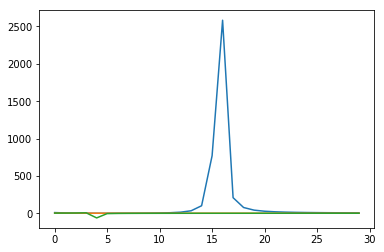

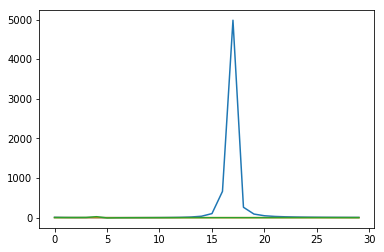

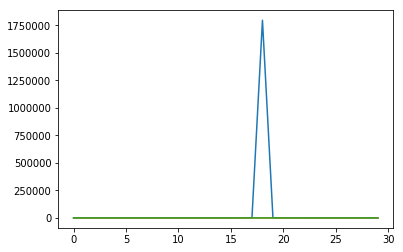

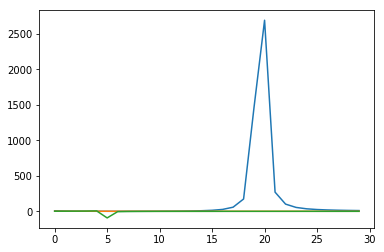

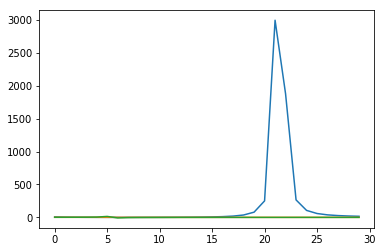

...

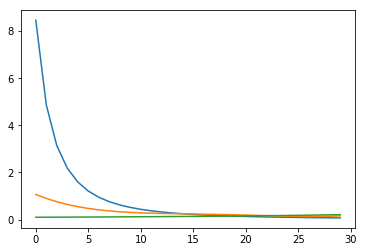

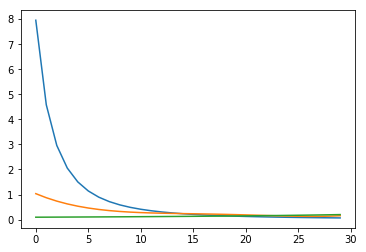

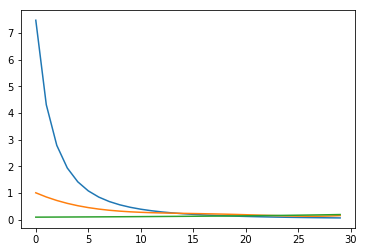

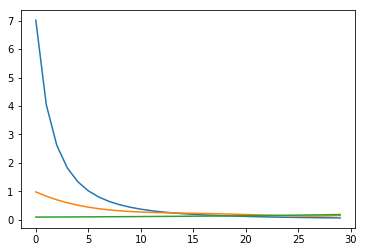

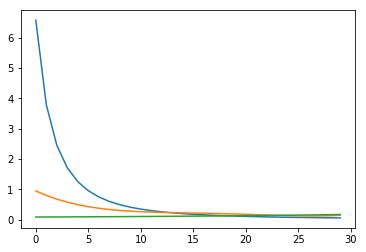

Iteration/Crit: [1, 1.9034621821164914]


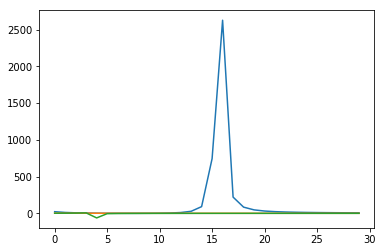

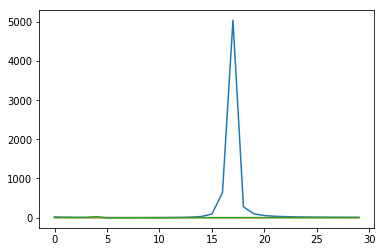

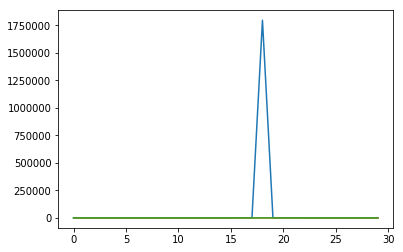

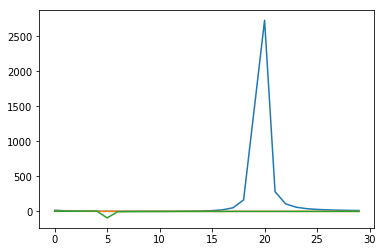

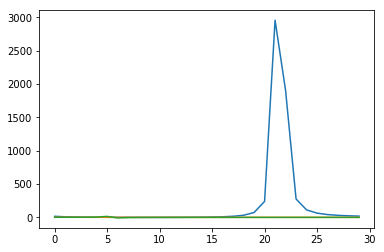

...

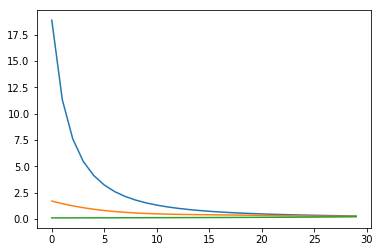

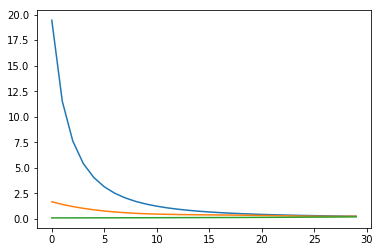

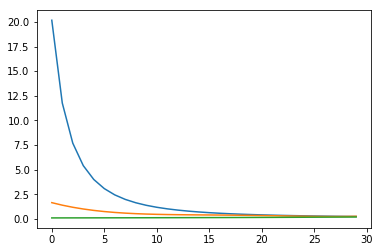

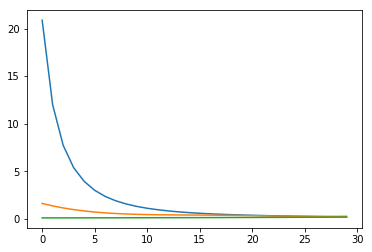

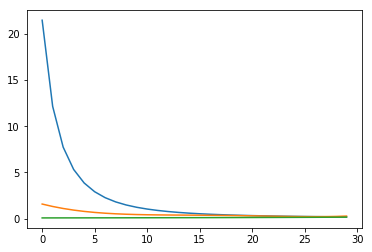

Iteration/Crit: [2, 1.9299795953112924]


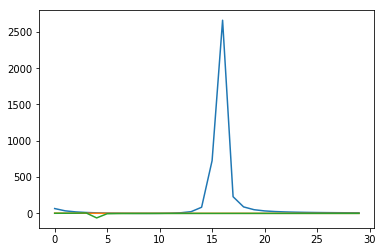

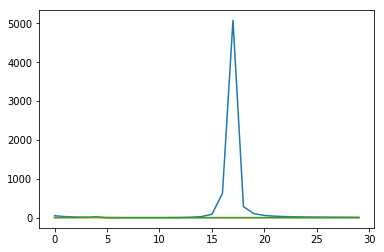

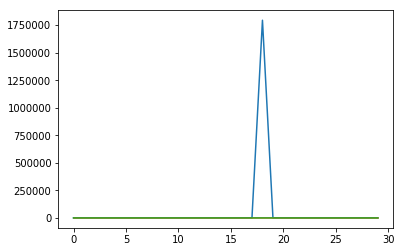

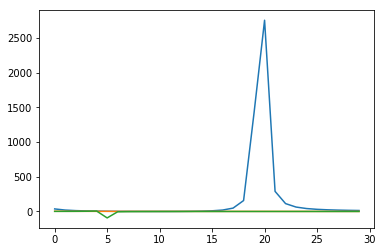

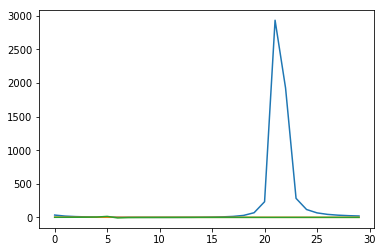

...

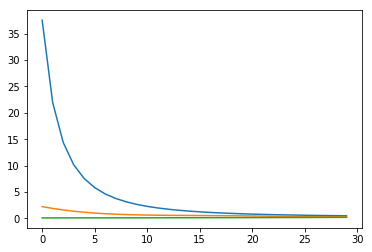

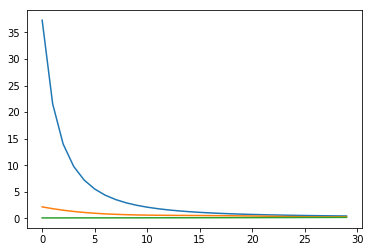

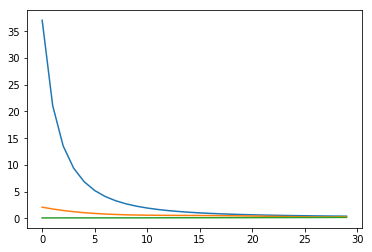

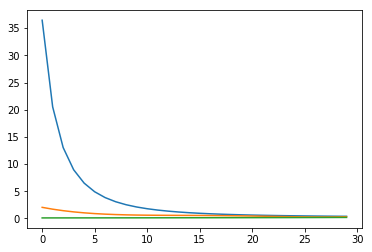

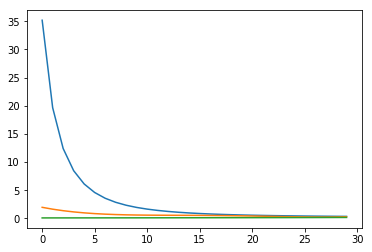

Iteration/Crit: [3, 1.8794361280307248]


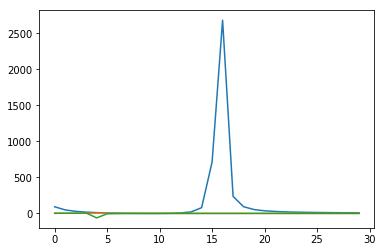

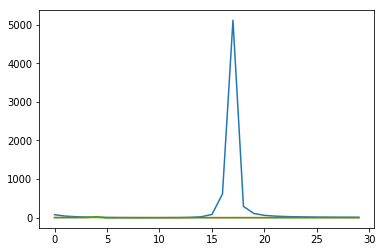

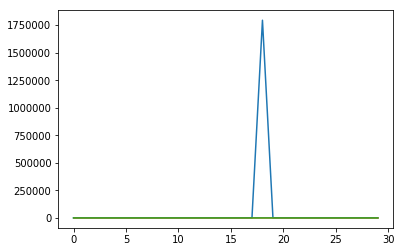

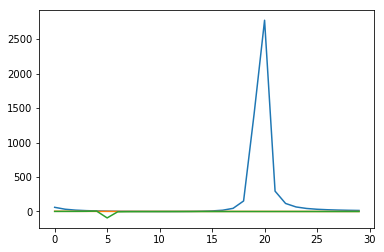

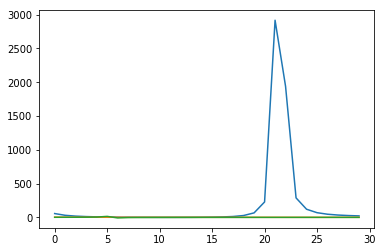

...

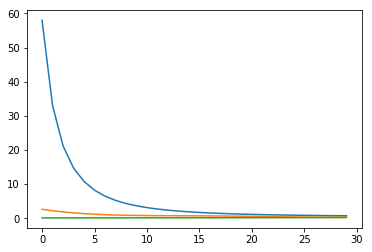

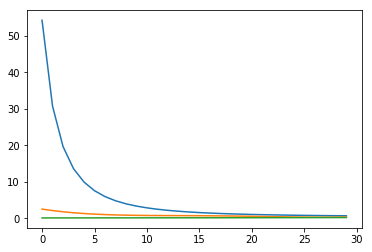

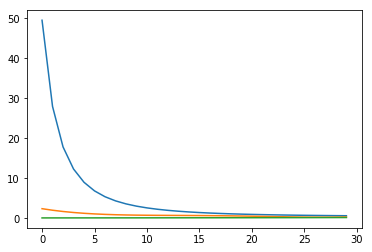

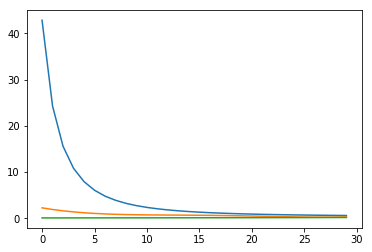

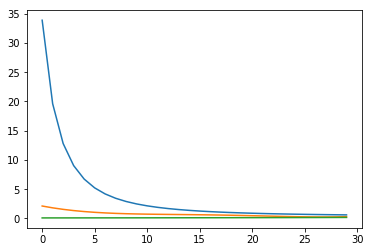

Iteration/Crit: [4, 1.7333125000592373]


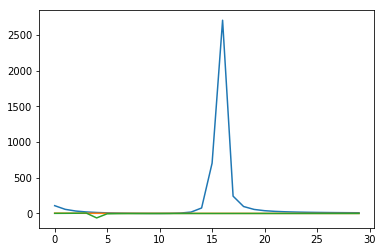

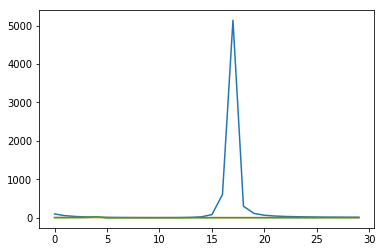

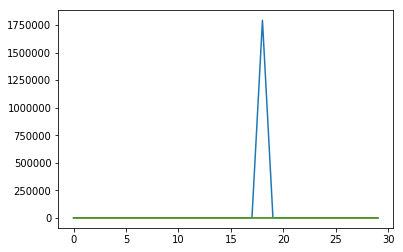

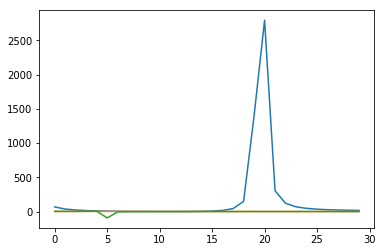

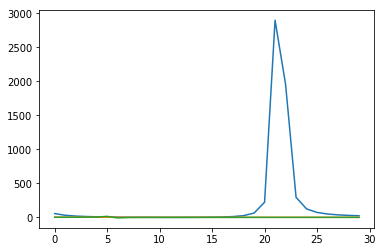

...

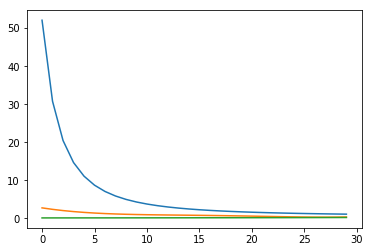

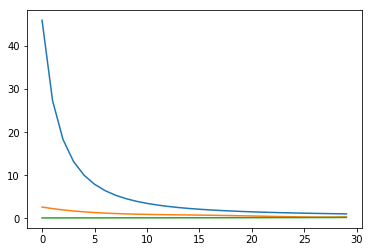

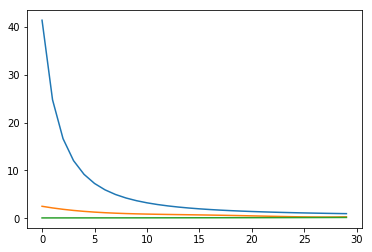

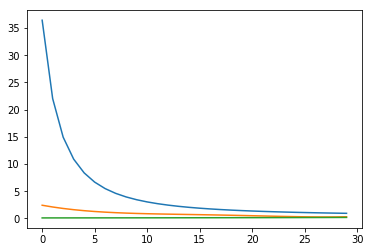

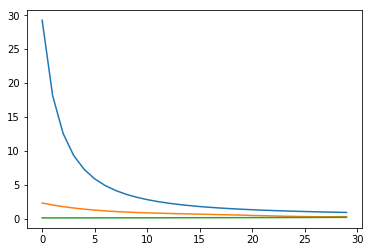

Iteration/Crit: [5, 1.7662807298196181]


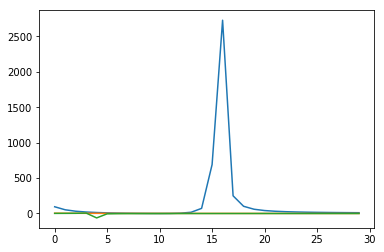

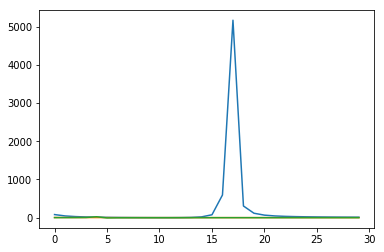

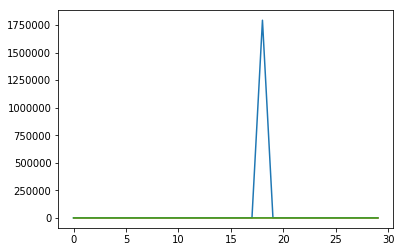

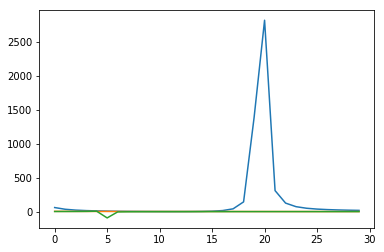

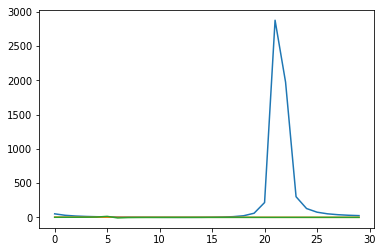

...

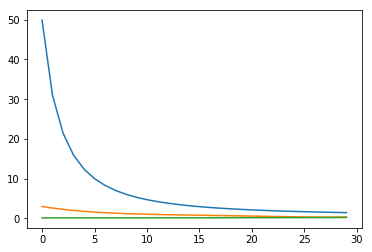

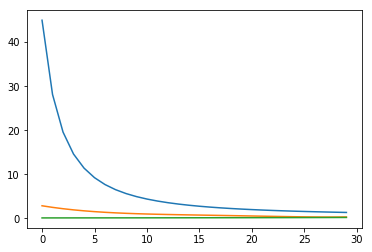

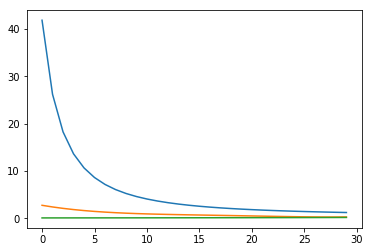

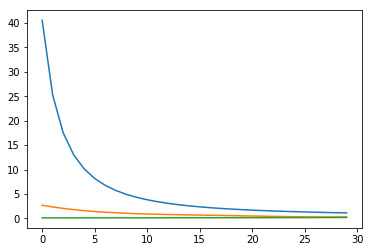

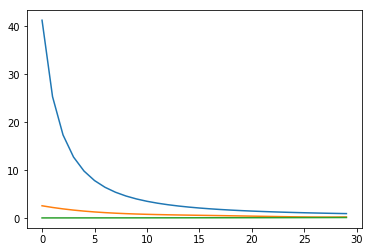

Iteration/Crit: [6, 1.7058480911291216]


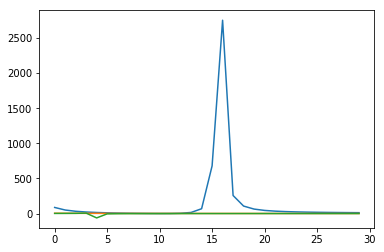

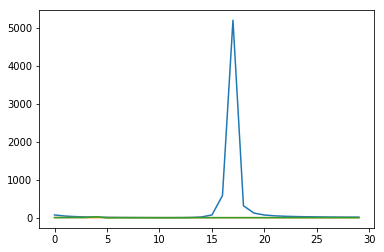

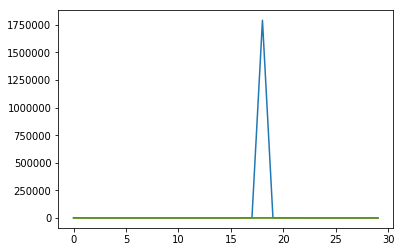

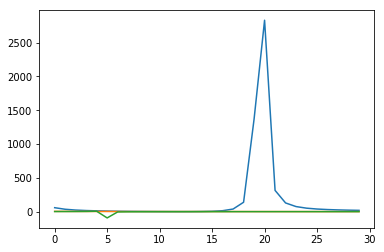

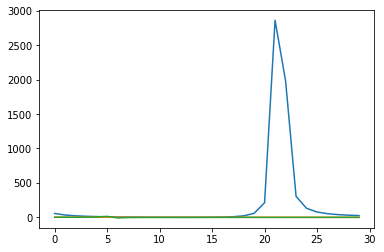

...

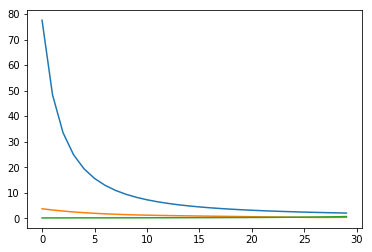

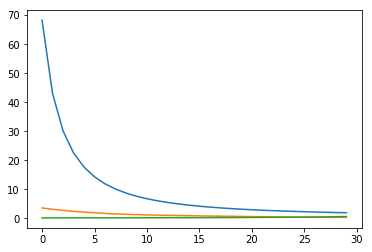

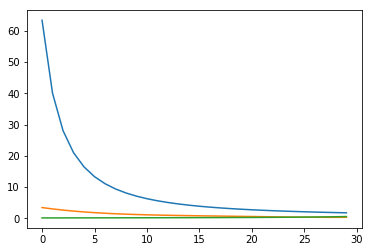

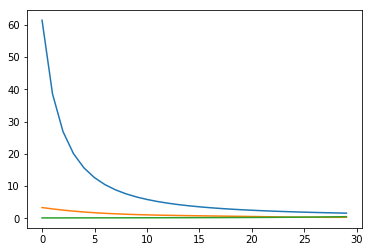

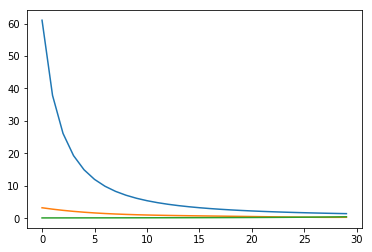

Iteration/Crit: [7, 1.6710901019007398]


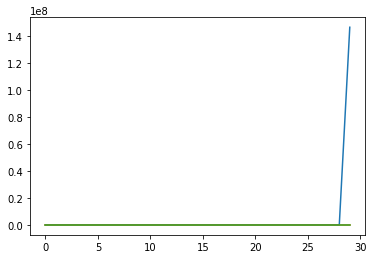

Iteration/Crit: [8, 1.6627672954168489]


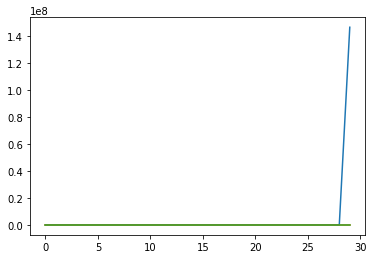

Iteration/Crit: [9, 1.7052512853089574]


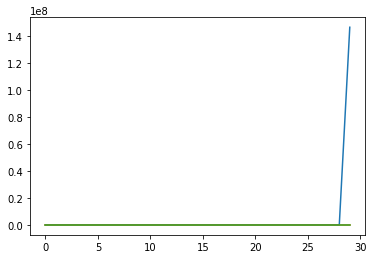

Iteration/Crit: [10, 1.7444724606413367]


KeyboardInterrupt: 

In [13]:
# Basic case

utility_mode = 0
interpolation_mode = 0

model = solve_model_time_iteration(beta, nk, ns, delta, eps, max_iter, utility_mode, interpolation_mode)
plot_policy(model)